# Team 1: Characterizing the spatiotemporal changes of wildland-urban interface in the United States

## Background

The wildland-urban interface (WUI) indicates the interface areas between the urban environment and wilderness. WUI areas come with a large risk of wildfire, and with the increased migration and associated development, these WUI areas gain more fuel for wildfires to burn more intensely. The purpose of the project is to map WUI areas in the United States using current definitions and to apply the mapped WUI areas to characterize spatiotemporal changes by taking advantage of the advances in HPC, cyberGIS, machine learning, and/or big data. Examples of such changes could include the geographic extent of WUI areas, spatiotemporal trends of demographic factors, changes in wildfire activities over recent decades, and/or changes to vegetation and climate drivers of wildfire in WUI areas.

## Motivation

Interactions between humans and nature has resulted in ongoing conflicts and considerations for the proper management of socio-ecological systems. On such conflict is the continual urbanization of land within the United States has led to increasing human encroachment into natural wildlands. The presence of WUIs has important implications for wildfire management, as these areas are at high risk of wildfires due to the large extent of flammable material and human activity (Li et al., 2022). Most wildfire disasters occur at the WUI

## Methodology Overview

**WUI Definitions:**
Wildland Urban-Interface (WUI) Community exists where structures directly abut wildland fuels and the Intermix Community exists where structures are scattered throughout a wildland area.

**WUI Criteria:**
WUI area should meet requirements of a) intermix: high-density houses surrounded by high-density wildland vegetation (50% of vegetation area) or b) interface: high-density houses adjacent to, that is within 1.5 miles (2.4 km) of a large tract of contiguous wildland vegetation (75% of vegetation area).
High-density housing is ≥ 1 house/40 acres (6.17 houses/km2 or 1 house/400m resolution grid cell).

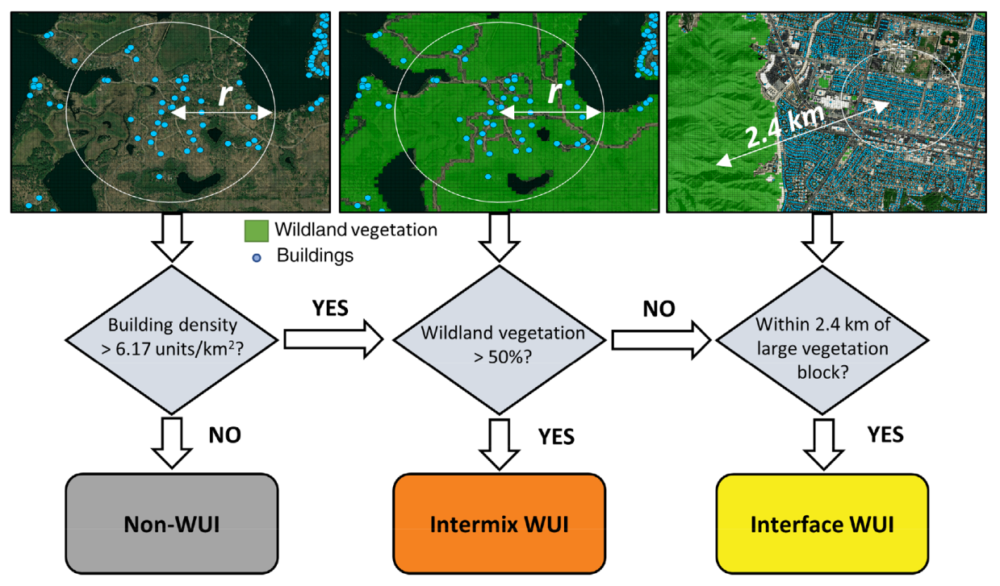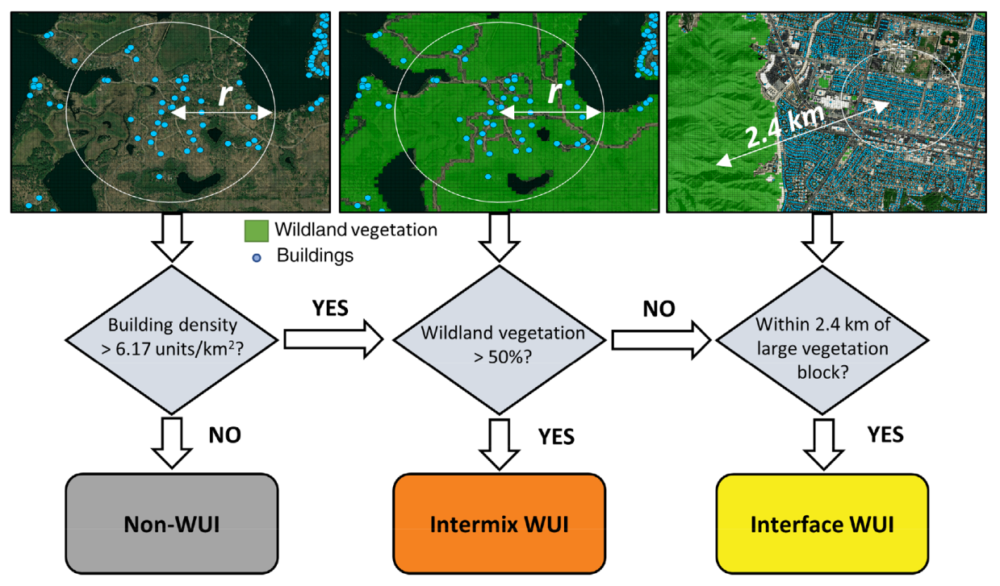

For the purposes of our week-long project, we were only able to map the WUI intermix. Mapping the WUI on Google Earth Engine is very computationally intensive, particularly because vegetation is being mapped at a 30m by 30m resolution. Mapping the WUI interface will be postponed for further research.

## Mapping the Wildland Urban Interface

### Install and import libraries and authenticate to Earth Engine

In [ ]:
# Must have Earth Engine account to authenticate

import ee
# import geemap
import geemap.foliumap as geemap

ee.Authenticate()
ee.Initialize()

### Wildland Urban Intermix

The **Intermix WUI** are areas with more than 6.17 buildings per km2 (or **one building per 40 acres**) and **a wildland vegetation area share of greater than or equal to 50%.**

### Vegetation Layer

Developing Vegetation Images

In [ ]:
# Import National Land Cover Database Image and get projection for transforming future images
nlcd_i = ee.Image('USGS/NLCD_RELEASES/2019_REL/NLCD/2019')#Change the year for different years
projection = nlcd_i.projection()

# Remap NLCD as binary image for "natural" vegetation — not including aquatic or low fuels (barren) types
veg_i = nlcd_i.select('landcover').remap([41,42,43,52,71],[1, 1, 1, 1, 1],0)

# Define kernel based on WUI definition and perform moving window (reduceNeighborhood)
kernel = ee.Kernel.circle(226.195, 'meters')
countCir = veg_i.reduceNeighborhood(reducer=ee.Reducer.mean(), kernel=kernel).reproject(crs=projection)
threshold50abv = countCir.gte(0.5)

### Building Layer

Develop building images

In [ ]:
# Import states Feature Collection and select CONUS states to iterate over
states_fc = ee.FeatureCollection("TIGER/2018/States")
conusStates = states_fc.filter(ee.Filter.inList('STUSPS', ['AK', 'HI']).Not())
conusGeometry = conusStates.geometry()

# Remap NLCD as binary image for developed areas for performing timeseries masking of buildings
dev_i = nlcd_i.select('landcover').remap([21,22,23,24],[1, 1, 1, 1],0)

# Convert Microsoft Buildings State Feature Collection to Image at resolution of NLCD
def get_state_image(path):
    fc = ee.FeatureCollection(path)
    new_fc = fc.map(lambda feature: feature.set("build", 1))
    image_fc = new_fc.reduceToImage(
        properties=['build'],
        reducer=ee.Reducer.sum()
    ).reproject(
        crs=nlcd_i.projection(),
        scale=30
    ).gt(0)
    return image_fc

# Run moving window function to produce 30m binary image of pixels that satisfy WUI building density definition
def run_state(folder):
    path = folder["id"]
    st_name = path[45:]
    state_f = ee.Feature(states_fc.filter(ee.Filter.eq('NAME', st_name)).first())
    st_image_fc = get_state_image(path)
    year_building = dev_i.multiply(st_image_fc)
    kernel = ee.Kernel.circle(226.195, 'meters')
    house_den = year_building.reduceNeighborhood(
        reducer=ee.Reducer.mean(),
        kernel=kernel,
    ).reproject(
        crs=projection,
    )
    dense_houses = house_den.gt(0)
    return dense_houses

# Run functions above to generate Image Collection of 30m binary image of pixels that satisfy WUI building density definition for each state
def list_ee_assets(folder):
    return [asset['id'] for asset in ee.data.listAssets({'parent': folder})['assets']]

buildings_dir = list_ee_assets('projects/sat-io/open-datasets/MSBuildings/US')
buildings = []

for i in buildings_dir:
    new_layer = run_state({'id': i})
    buildings.append(new_layer)

buildings = ee.ImageCollection(buildings).reduce(ee.Reducer.max())

### Generating combined WUI Intermix

Combine Building and Vegetation Layers

In [ ]:
# Generate output that satisfies both vegetation and building requirements of WUI definition
wuimix = threshold50abv.multiply(buildings)
mask = wuimix.eq(1)
wuimix = wuimix.updateMask(mask)

### Displaying the Map with geemap

In [ ]:
# Define visualization area for map
colorado = states_fc.filter(ee.Filter.eq('NAME', 'Colorado'))
boulder = ee.Geometry.Point([-105.2705, 40.0150])

In [ ]:
Map = geemap.Map()
Map.add_basemap('SATELLITE')
vis_params_WUImix = {
    'min': 0,
    'max': 1,
    'palette': ['FFFFFF00', 'FF0000'],
    'opacity': 0.5
}
Map.addLayer(nlcd_i.select('landcover'), {}, 'NLCD Land Cover', False)
Map.addLayer(wuimix, vis_params_WUImix, 'WUImix')
Map.centerObject(boulder, 12)
Map

## Mapping social vulnerability

Visualization of the Social Vulnerability Index (NASA SEDAC) and Wildfire Risk to Communities Risk to Potential Structures (US Forest Service, LANDFIRE) for the Wildland Urban Interface. The Social Vulnerability Index was downloaded from https://sedac.ciesin.columbia.edu/data/set/usgrid-us-social-vulnerability-index and the LANDFIRE data was already an Earth Engine asset, so could be processed in EE.

In [ ]:
Map = geemap.Map(center=(40, -100), zoom=4)

# Import the Wildfire Risk to Communities Risk to Potential Structures collection and mosaic
hpb = ee.ImageCollection('projects/climate-engine-pro/assets/ce-wrc-static').select('RPS').mosaic()

# Define visualization parameters for Risk to Potential Structures and map
hpb_c = ["#ffffb2", "#fed976", "#feb24c", "#fd8d3c", "#fc4e2a", "#e31a1c", "#b10026"]
Map.addLayer(hpb, {'min':0, 'max':1, 'palette': hpb_c},'Risk')

# Import the Social Vulnerability Index image
svi = ee.Image('projects/dri-apps/assets/iguide-team1/svi_2014')

# Define visualization parameters for Social Vulnerability Index and map
svi_c = ["#edf8fb", "#bfd3e6", "#9ebcda", "#8c96c6", "#8c6bb1", "#88419d", "#6e016b"]
Map.addLayer(svi, {'min':0, 'max':1, 'palette': svi_c},'Vulnerability')

# Import Wildland Urban Intermix image and mask 0 values
intermix = ee.ImageCollection('projects/dri-apps/assets/iguide-team1/intermix')
intermix = intermix.mosaic().selfMask()

# Define visualization parameters for Wildland Urban Intermix and map
intermix_c = ['#D8B365','#F5F5F5','#5AB4AC']
Map.addLayer(intermix, {'min':0, 'max':1, 'palette': intermix_c},'WUI')

# Apply mask to visualize Social Vulnerability Index only in the WUI
svi_mask = svi.updateMask(intermix)
Map.addLayer(svi_mask, {'min':0, 'max':1, 'palette': svi_c},'Vulnerability WUI')

# Apply mask to visualize Risk to Potential Structures only in the WUI
hpb_mask = hpb.updateMask(intermix)
Map.addLayer(hpb_mask, {'min':0, 'max':1, 'palette': hpb_c},'Risk WUI')

Map

## Mapping and analyzing the Wildland Urban Interface through time

While the National Land Cover Database is available at 2-3 year intervals since 2000, the Microsoft Building Footprints are produced for a single point in time using modern imagery. To assess change in the Wildland Urban Interface as a timeseries, the team applied a novel approach to create a pseudo timeseries of building footprints.

For each NLCD timestep, the Microsoft Buildings were masked if they were not included in NLCD developed classes. In general, there is strong correspondence between NLCD developed classes and building footprints in the contemporary datasets, lending confidence to using this methodology to produce the pseudo-timeseries. Future validation will be completed to further assess the appropriateness of this approach.

Disclaimer: Owing to time constraints of the project, the code below is computationally inefficient. When using Earth Engine, for loops are discouraged to avoid iterating over mixed client-side and server-side operations. The code below will be rewritten using python functions and the use of the Earth Engine .map() method to iterate over the functions. However, we chose to keep the code below in the notebook as it reflects the body of work completed by the team.

See section "Precomputed outputs" below to see project visualizations

In [ ]:
### Preliminary code — to be reworked, see disclaimer above

In [ ]:
if __name__ == '__main__':
    states_fc = ee.FeatureCollection("TIGER/2018/States")
    conusStates = states_fc.filter(ee.Filter.inList('STUSPS', ['AK', 'HI']).Not())
    conusGeometry = conusStates.geometry()
    buildings_dir = list_ee_assets('projects/sat-io/open-datasets/MSBuildings/US')

    def list_ee_assets(folder):
        return [asset['id'] for asset in ee.data.listAssets({'parent': folder})['assets']]

    def get_state_image(path):
        fc = ee.FeatureCollection(path)
        new_fc = fc.map(lambda feature: feature.set("build", 1))
        image_fc = new_fc.reduceToImage(
            properties=['build'],
            reducer=ee.Reducer.sum()
        ).reproject(
            crs=nlcd_i.projection(),
            scale=30
        ).gt(0)
        return image_fc

    def run_state(folder):
        path = folder["id"]
        st_name = path[45:]
        state_f = ee.Feature(states_fc.filter(ee.Filter.eq('NAME', st_name)).first())
        st_image_fc = get_state_image(path)
        year_building = dev_i.multiply(st_image_fc)
        kernel = ee.Kernel.circle(226.195, 'meters')
        house_den = year_building.reduceNeighborhood(
            reducer=ee.Reducer.mean(),
            kernel=kernel,
        ).reproject(
            crs=projection
        )
        dense_houses = house_den.gt(0)
        return dense_houses

    def get_yearly_wui(year, store=False):
        nlcd_i = ee.Image('USGS/NLCD_RELEASES/2019_REL/NLCD/' + year)
        projection = nlcd_i.projection()

    # 50% vegetation area
    veg_i = nlcd_i.select('landcover').remap([41,42,43,52,71],[1, 1, 1, 1, 1],0)
    kernel = ee.Kernel.circle(226.195, 'meters')
    countCir = veg_i.reduceNeighborhood(reducer=ee.Reducer.mean(), kernel=kernel).reproject(crs=projection)
    threshold50abv = countCir.gte(0.5)

    # Get the dense housings
    dev_i = nlcd_i.select('landcover').remap([21,22,23,24],[1, 1, 1, 1],0)
    dense_houses = []
    for i in buildings_dir:
        new_layer = run_state({'id': i})
        dense_houses.append(new_layer)

    dense_houses = ee.ImageCollection(dense_houses).reduce(ee.Reducer.max())

    cr_a = threshold50abv.multiply(dense_houses)
    mask_a = cr_a.eq(1)
    cr_a = cr_a.updateMask(mask_a).reproject(crs=projection, scale=400)

    # if store:
    #     geemap.ee_export_image_to_drive(cr_a, description='jWUImix_' + year, folder='GoogleEarthEngine', scale=30, maxPixels=1700000000000)

    years = ["2011", "2013", "2016", "2019"]
    wuis = [get_yearly_wui(year, False) for year in years]

Run Only For Exporting WUI Intermix Map:

In [ ]:
#geemap.ee_export_image_to_drive(wuimix, description='WUImix11', folder='sample_data', scale=30, maxPixels=17000000000)

#### State-wise WUI intermix

In [ ]:
st_codes = [
    'AL', 'AZ', 'AR', 'CA', 'CO', 'CT', 'DE', 'FL', 'GA',
    'HI', 'ID', 'IL', 'IN', 'IA', 'KS', 'KY', 'LA', 'ME', 'MD',
    'MA', 'MI', 'MN', 'MS', 'MO', 'MT', 'NE', 'NV', 'NH', 'NJ',
    'NM', 'NY', 'NC', 'ND', 'OH', 'OK', 'OR', 'PA', 'RI', 'SC',
    'SD', 'TN', 'TX', 'UT', 'VT', 'VA', 'WA', 'WV', 'WI', 'WY'
]

intermix_pre = ee.ImageCollection('projects/dri-apps/assets/iguide-team1/intermix')
im_pre=intermix_pre.mosaic().selfMask()

intermix_next = ee.ImageCollection('projects/dri-apps/assets/iguide-team1/intermix2019')
im_next=intermix_next.mosaic().selfMask()

def state_columns(feature):
    # Get the STUSPS property from the feature
    stusps = feature.get("STUSPS")

    # Get values from the server-side dictionaries using .get() operations
    a = wui_area_dict_server.get(stusps)
    b = area_dict_server.get(stusps)
    c = wui_percent_dict_server.get(stusps)

    updatedProps = feature.set('WUI_area', a).set('Area', b).set("WUI_percent", c)
    return updatedProps


def yearly_statewise_wui(wui):
    global wui_area_dict_server, area_dict_server, wui_percent_dict_server
    wui_area_dicts = {}
    area_dicts = {}
    wui_percent_dicts = {}

    states_fc = ee.FeatureCollection("TIGER/2018/States");

    for st_code in st_codes:
        print("====", st_code)
        st = states_fc.filter(ee.Filter.inList('STUSPS', [st_code])).first()
        #print(st)
        wui_clipped = wui.clip(st)
        countResult = wui_clipped.reduceRegion(
            reducer= ee.Reducer.sum(),
            geometry= st.geometry(),
            scale= 30,
            maxPixels= 1e20)
        wui_area = countResult.getInfo()['b1']/1e+6 * 900
        st_area = st.geometry().area().getInfo()/1e+6
        area_dicts[st_code] = st_area
        wui_area_dicts[st_code] = wui_area
        wui_percent_dicts[st_code] = round(wui_area/st_area*100,2)
        print(st_code, area_dicts[st_code], " sqkm")

    area_dict_server = ee.Dictionary(area_dicts)
    wui_area_dict_server = ee.Dictionary(wui_area_dicts)
    wui_percent_dict_server = ee.Dictionary(wui_percent_dicts)

    states_fc = states_fc.filter(ee.Filter.inList('STUSPS', st_codes))
    fin_states_fc = states_fc.map(state_columns)
    return(fin_states_fc)

state_wui_2019 = yearly_statewise_wui(im_next)
print("-----------------------------------------------")
state_wui_2011 = yearly_statewise_wui(im_pre)

In [ ]:
Map = geemap.Map()

Map.centerObject(state_wui_2019, 4);
Map.addLayer(state_wui_2019)
Map

# 2019 WUI's statewise area (sqkm)

In [ ]:
Map = geemap.Map()

Map.centerObject(state_wui_2019, 4);
Map.addLayer(state_wui_2019)
Map

# 2019 WUI's statewise WUI cover (%)

In [ ]:
Map = geemap.Map()

Map.centerObject(state_wui_2011, 4);
Map.addLayer(state_wui_2011, {})
Map

# 2011 WUI's statewise area (sqkm)

In [ ]:
Map = geemap.Map()

Map.centerObject(state_wui_2011, 4);
Map.addLayer(state_wui_2011)
Map

# 2011 WUI's statewise WUI cover (%)

### Precomputed outputs

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

image_paths = [
    'Team1/images/Boulder_WUI_11.PNG',
    'Team1/images/Boulder_WUI_13.PNG',
    'Team1/images/Boulder_WUI_16.PNG',
    'Team1/images/Boulder_WUI_19.PNG'
]

f, axarr = plt.subplots(2, 2, figsize=(50, 30))

images = [mpimg.imread(image_path) for image_path in image_paths]


titles = ["Boulder WUI Interface 2011", "Boulder WUI Interface 2013", "Boulder WUI Interface 2016", "Boulder WUI Interface 2019"]
for i, ax in enumerate(axarr.flat):
    ax.imshow(images[i])
    ax.set_title(titles[i],
          fontsize = 40)
    ax.axis('off')

plt.tight_layout()
plt.show()

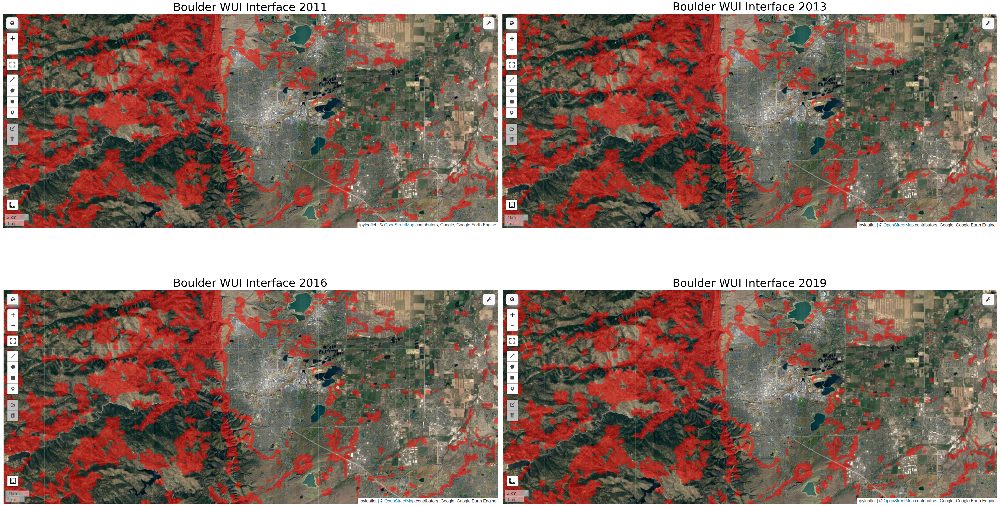

In [ ]:
image_paths = [
    'Team1/images/Boulder_USDA_WUI_11.png',
    'Team1/images/Boulder_WUI_11.PNG'
]

f, axarr = plt.subplots(1, 2, figsize=(50, 30))

images = [mpimg.imread(image_path) for image_path in image_paths]


titles = ["Colorado WUI Interface 2011", "Boulder WUI Interface 2011"]
for i, ax in enumerate(axarr.flat):
    ax.imshow(images[i])
    ax.set_title(titles[i],
          fontsize = 40)
    ax.axis('off')

plt.tight_layout()
plt.show()

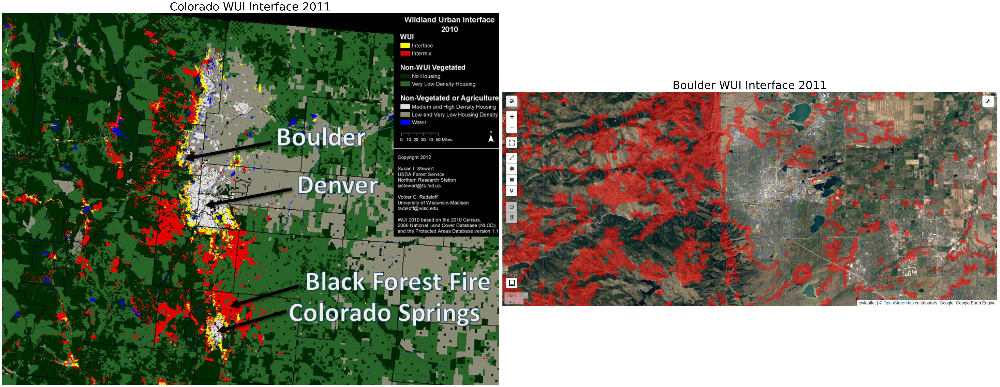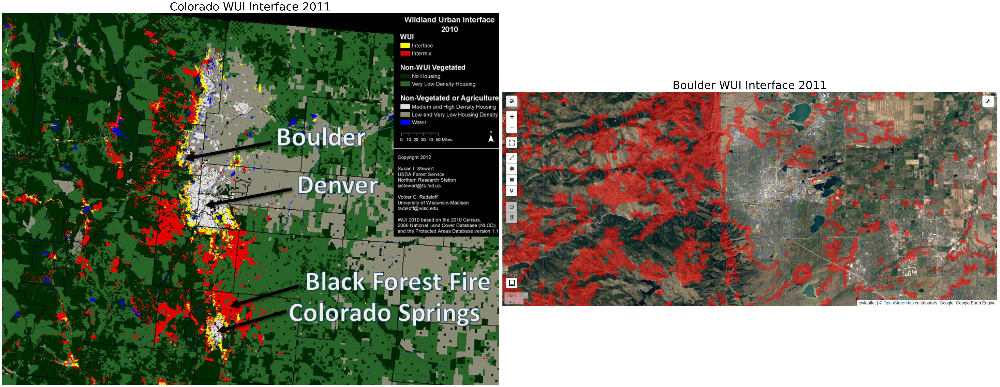

## Ethics

### Data Science Ethics Checklist

[![Deon badge](https://img.shields.io/badge/ethics%20checklist-deon-brightgreen.svg?style=popout-square)](http://deon.drivendata.org/)

#### Database Limitations
 - [ ] **Social Vulnerability Index (SVI)**
 >*SVI is a relative score for a locality based upon other localities, so if you're looking at changes over time, changes in vulnerability in a locality may not actually reflect changes within that locality. Additionally, the SVI is based upon Census data, which has its own limitations, such as uncertainty in American Community Survey estimates.*
 - [ ] **National Land Cover Database (NLCD)**
 >*The NLCD has a documented accuracy of 82.0%. In one research paper, scientists found the NLCD significantly underestimates tree cover with a national average underestimation of 9.7% and a max underestimation of 28.4%.*
 - [ ] **Microsoft Building Footprint**
 >*The database is said to be 99.3% precise and have 93.5% recall as matching building metrics.Researchers report the algorithm fails to detect small buildings, that attached buildings with similar heights are consolidated to form single polygons, and that overcounting is an issue in some places.*

#### A. Data Collection
 - [ ] **A.1 Informed consent**: If there are human subjects, have they given informed consent, where subjects affirmatively opt-in and have a clear understanding of the data uses to which they consent?
 >*No, people taking the Census don’t necessarily give informed consent to have their data shared/published, or used for research purposes. On the MIcrosoft Building blueprints side, people do not opt-in to having their house or building included in the dataset.*
 - [ ] **A.2 Collection bias**: Have we considered sources of bias that could be introduced during data collection and survey design and taken steps to mitigate those?
 >*The Social Vulnerability Index (SVI) we are using takes into account 15 different variables at the census tract level, including race. The way the Census accounts for race is not holistic enough, and leaves a lot to be desired. Some of the descriptors for the variables in the index are self-explanatory, but others are not. For example, income and minority are listed as variables, but there’s no further information on exactly what these variables mean.*
 - [ ] **A.3 Limit PII exposure**: Have we considered ways to minimize exposure of personally identifiable information (PII) for example through anonymization or not collecting information that isn't relevant for analysis?
 >*Census data in the SVI is anonymous in and of itself, so this isn’t an issue we need to worry about. We aren’t attaching identifiers to any of the data we’re using, and we’re only putting in the data necessary to answer our research question.*
 - [ ] **A.4 Downstream bias mitigation**: Have we considered ways to enable testing downstream results for biased outcomes (e.g., collecting data on protected group status like race or gender)?
 >*Using Census/ACS data is difficult because only a small subset of the population is sampled. How random are those samples? Are areas of all races/socioeconomic classes being evaluated? There is also missing data for a bunch of tracts because the ACS only samples certain areas. Therefore, downstream results could lead to a biased outcome if certain racial or income groups are over- or underrepresented in the SVI.*

#### B. Data Storage
 - [ ] **B.1 Data security**: Do we have a plan to protect and secure data (e.g., encryption at rest and in transit, access controls on internal users and third parties, access logs, and up-to-date software)?
 >*No, all our data is already publicly available, so we have no further plans to protect and secure our data.*
 - [ ] **B.2 Right to be forgotten**: Do we have a mechanism through which an individual can request their personal information be removed?
 >*Once you have filled out the Census, you have no way of removing your information. Therefore, there is no mechanism by which a person can be removed from the dataset; however, individuals cannot be tied to the dataset due to anonymity, so we don’t foresee this being an issue.*
 - [ ] **B.3 Data retention plan**: Is there a schedule or plan to delete the data after it is no longer needed?
 >*There are no plans for any data (which is publicly available and historical) to ever be deleted or removed, for any of the databases we’re using.*

#### C. Analysis
 - [ ] **C.1 Missing perspectives**: Have we sought to address blindspots in the analysis through engagement with relevant stakeholders (e.g., checking assumptions and discussing implications with affected communities and subject matter experts)?
 >*We recognize that the data we are using could have some issues/blindspots. The Land Use/Vegetation dataset, for example, often significantly underestimates tree cover in areas across the US. Microsoft’s Building Footprint is AI-based mapping, and some building counts are often off due to mishaps in the algorithm.*
 - [ ] **C.2 Dataset bias**: Have we examined the data for possible sources of bias and taken steps to mitigate or address these biases (e.g., stereotype perpetuation, confirmation bias, imbalanced classes, or omitted confounding variables)?
 >*We recognize there is a margin of error associated with ACS data used in the SVI, but there isn’t really a way to mitigate those errors; however, the SVI has a methodology for dealing with margin of errors and missing values in ACS data. It is also recognized as a limitation of the dataset.*
 - [ ] **C.3 Honest representation**: Are our visualizations, summary statistics, and reports designed to honestly represent the underlying data?
 >*We plan to use our visualizations and reports to accurately represent our findings. Map color will be based on intuition (with darker colors and/or reds corresponding to more affected areas) and legends will be prominent enough that the message will be straightforward.*
 - [ ] **C.4 Privacy in analysis**: Have we ensured that data with PII are not used or displayed unless necessary for the analysis?
 >*We have no PII in our datasets.*
 - [ ] **C.5 Auditability**: Is the process of generating the analysis well documented and reproducible if we discover issues in the future?
 >*We will produce a Python notebook with detailed information on how our analysis was conducted. If issues arise in the future, we will be able to return to this notebook to confirm why certain decisions were made. Instructions will be explicitly stated within the code.*

#### D. Modeling
 - [ ] **D.1 Proxy discrimination**: Have we ensured that the model does not rely on variables or proxies for variables that are unfairly discriminatory?
 >*Possibly. Because of how the social vulnerability index is calculated, it seems like areas of high minorities and low income communities could be overrepresented in vulnerable areas. This will be noted as a limitation of using the SVI when we’re drawing up conclusions.*
 - [ ] **D.5 Communicate bias**: Have we communicated the shortcomings, limitations, and biases of the model to relevant stakeholders in ways that can be generally understood?
 >*We understand the shortcomings and limitations of the databases we are using, and have communicated those through our notebook.*

#### E. Deployment
 - [ ] **E.2 Redress**: Have we discussed with our organization a plan for response if users are harmed by the results (e.g., how does the data science team evaluate these cases and update analysis and models to prevent future harm)?
 >*We have not made a plan for potential harm yet, but that is a future conversation we plan on having.*
 - [ ] **E.4 Unintended use**: Have we taken steps to identify and prevent unintended uses and abuse of the model and do we have a plan to monitor these once the model is deployed?
 >*We have identified some potential unintentional uses, such as insurance companies using WUI classifications to raise prices for customers in those areas. WUI data (including exact/known WUI areas) will only be distributed if requested so we'll know where exactly it's going to.*

#### F. Additional/Miscellaneous Categories
 - [ ] **F.1 Database Years**: Does all the data come from the same year?
 >*Due to availability, there are some mismatches between the years of our databases. For example, for the 2014 fire data, we have to use the WUI from 2013. However, we don't forsee many changes occurring from year to year within the WUI and don't believe this will be a huge issue.*
 - [ ] **F.2 Mapping Limitations**: What limitations did we run into while mapping the WUI?
 >*We only mapped the WUI intermix (buildings surrounded by vegetation) did not map the WUI interface (buildings adjacent to wildland areas). Therefore, some of the towns that have been most affected by wildfire damage aren't included in our WUI*

*Data Science Ethics Checklist generated with [deon](http://deon.drivendata.org).*